**Сердюк, 474б. Вариант 3.** Инверсия цветов (негатив). Колоризация серого изображения на основе пары опорных цветов

Подготовительный этап. Определяем функцию для отображения изображений, создаём массив с исходными картинками и массив, в который будем добавлять все картинки, также для удобства приведём все картинки к единому размеру

In [1]:
import random
from PIL import Image, ImageDraw, ImageOps
import matplotlib.pyplot as plt

#функция вывода изображения
def draw_img(image):
  plt.figure(figsize=(8,8))
  plt.imshow(image)
  plt.show()

img_names = ['img1.jpg','img2.jpg','img3.jpg','img4.jpg']
new_img_names = ['img1.jpg','img2.jpg','img3.jpg','img4.jpg']

for i in img_names:
  image = Image.open(i) #Открываем изображение
  draw = ImageDraw.Draw(image) #Создаем инструмент для рисования
  image = image.resize((500,300), Image.ANTIALIAS)
  image.save(i)

**Задание 1.**

Поменяйте цвета своих изображений на противоположные в RGB
используя прямые вычисления значений для каждого из каналов.

Для этого мы возьмем схему RGB и будем для каждого канала - R, G и B, менять значения, вычитая актуальный из 255.

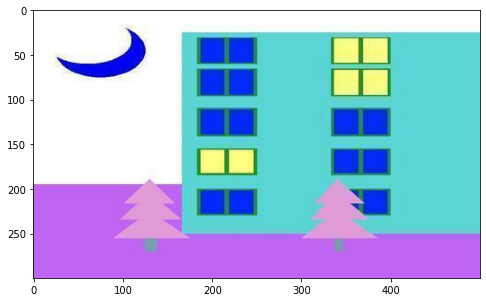

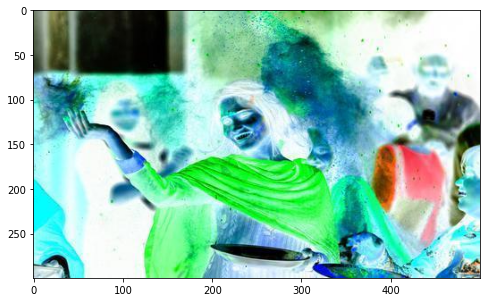

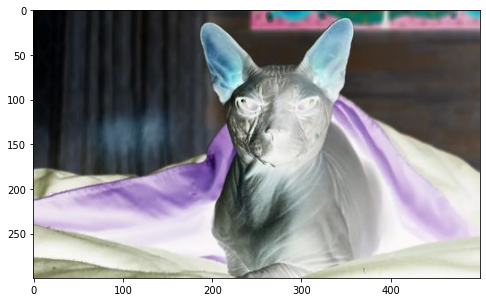

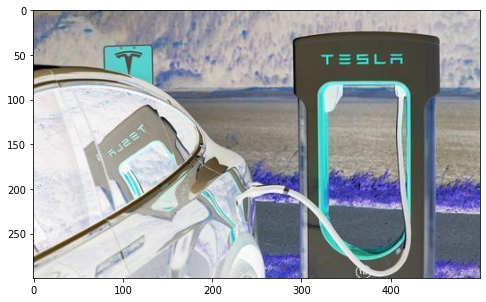

In [2]:
for _data in img_names:
  image = Image.open(_data)
  draw = ImageDraw.Draw(image)
  width = image.size[0]
  height = image.size[1] 

  pix = image.load()

  for x in range(width):
   for y in range(height):
      r, g, b = pix[x, y]
      draw.point((x, y), (255 - r, 255 - g, 255 - b))

  draw_img(image)
  image.save('hand_inverse_'+ _data)
  new_img_names.append('hand_inverse_'+ _data)

**Задание 2.** Получите инвертированные по цвету изображения с использованием
метода invert из модуля ImageOps библиотеки PIL.

(изначально я сверял ручную инверсию каналов этой функцией, но, как оказалось - это отдельное задание, хех)

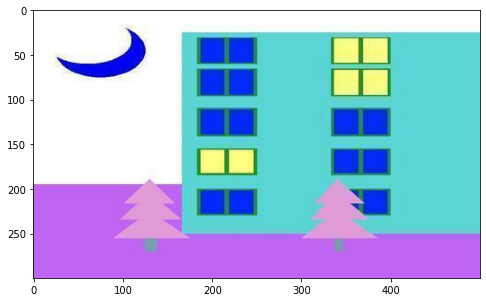

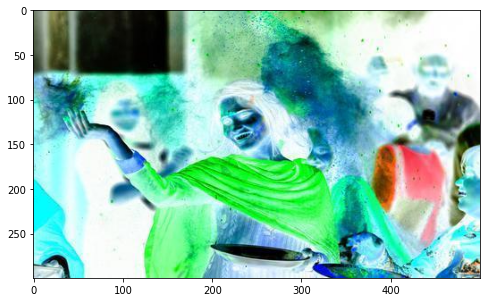

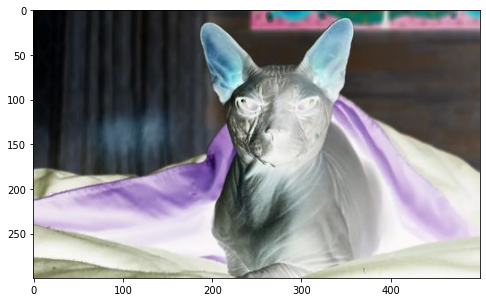

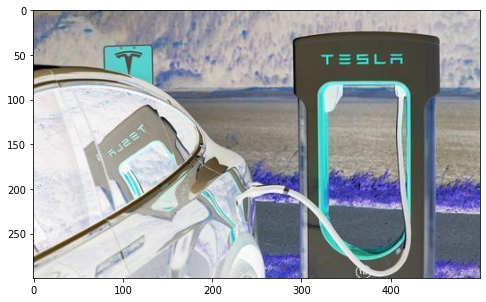

In [3]:
for _data in img_names:
  image = Image.open(_data)
  inverted_image = ImageOps.invert(image)
  draw_img(inverted_image)
  inverted_image.save('PIL_inverse_'+ _data)
  new_img_names.append('PIL_inverse_'+ _data)

**Задание 3.** Получите Grayscale-изображения (в градациях серого) с использованием
метода grayscale из модуля ImageOps библиотеки PIL, а затем раскрасьте
полученные изображения методом colorize из того же модуля, используя в
качестве пары базовых цветов не белый и черный, какой-то другой набор. Затем поменяйте эти цвета местами, проанализируйте полученные
результаты, сделайте выводы. Попробуйте после colorize использовать метод
invert из модуля ImageOps, что получится в этом случае?

Используем Grayscale

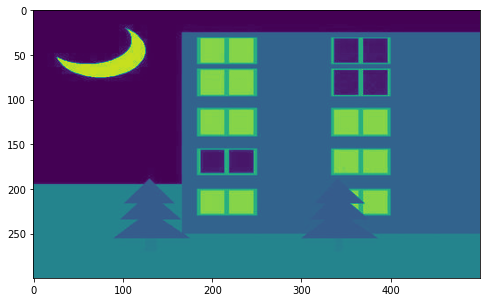

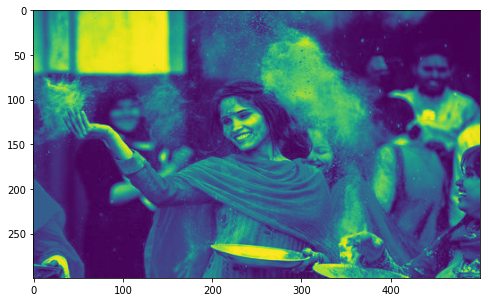

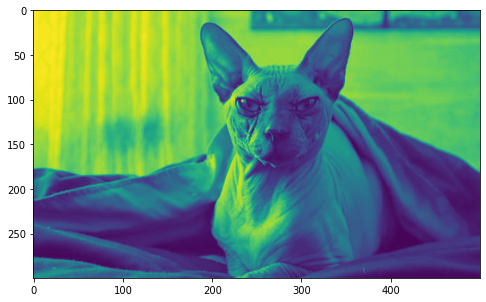

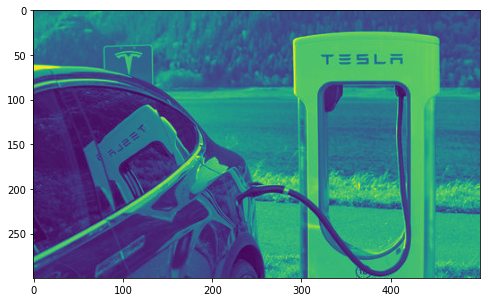

In [4]:
for _data in img_names:
  image = Image.open(_data)
  image = ImageOps.grayscale(image)
  draw_img(image)
  image.save('grayscale_'+ _data)
  new_img_names.append('grayscale_'+ _data)

Красим результаты Grayscale двумя цветами - зеленым и синим

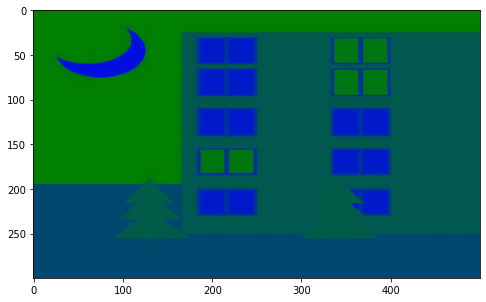

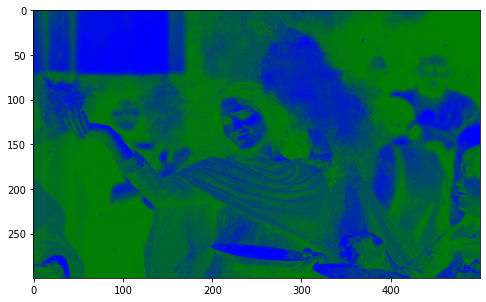

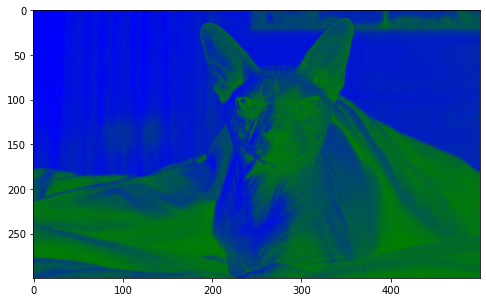

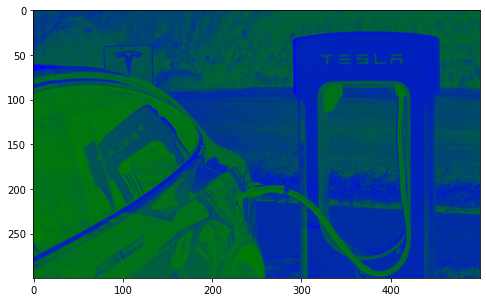

In [5]:
for _data in img_names:
  image = Image.open(_data)
  image = ImageOps.grayscale(image)

  image = ImageOps.colorize(image, 'green', 'blue')

  draw_img(image)
  image.save('grayscale_colorize_gb_'+ _data)
  new_img_names.append('grayscale_colorize_gb_'+ _data)

Меняем цвета местами

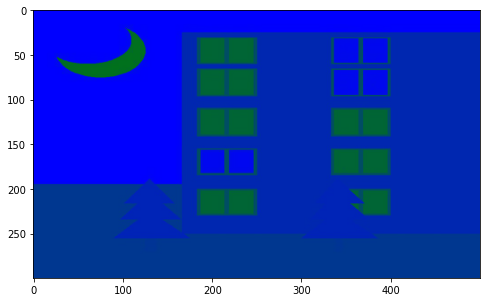

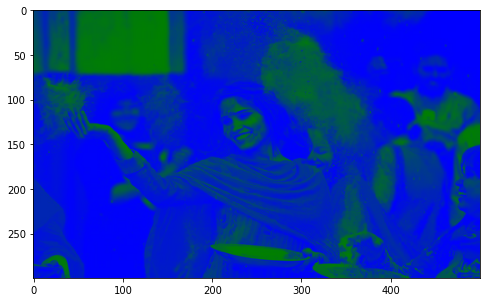

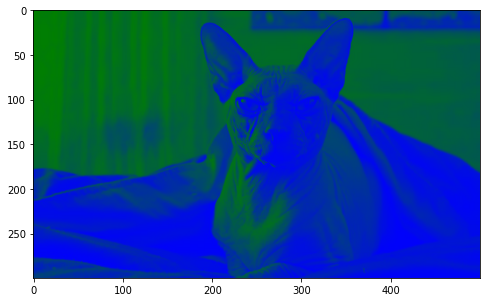

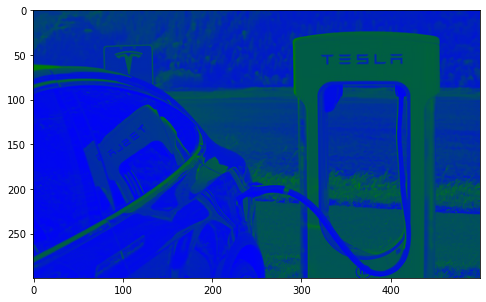

In [6]:
for _data in img_names:
  image = Image.open(_data)
  image = ImageOps.grayscale(image)

  image = ImageOps.colorize(image, 'blue', 'green')

  draw_img(image)
  image.save('grayscale_colorize_bg_'+ _data)
  new_img_names.append('grayscale_colorize_bg_'+ _data)

Colorize использует черно-белые изображения и закрашивает двумя цветами (с возможностью выбора оттенка и его позиции - черного или белого)

Используем invert после colorize в обоих случаях

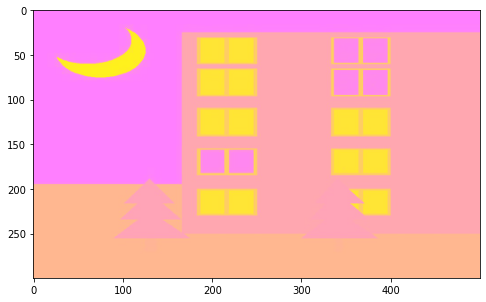

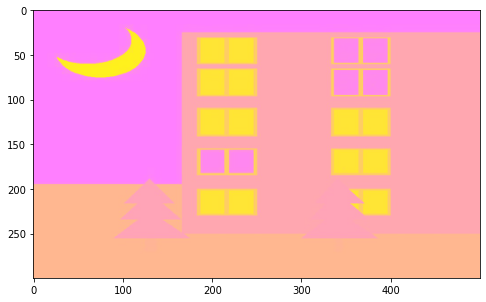

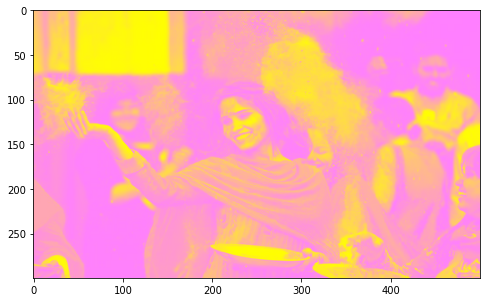

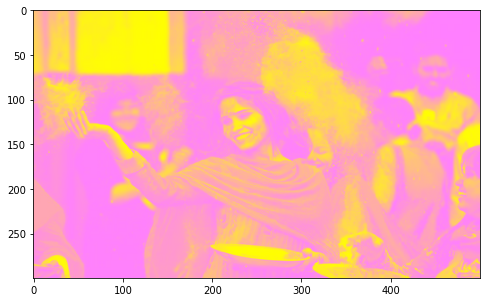

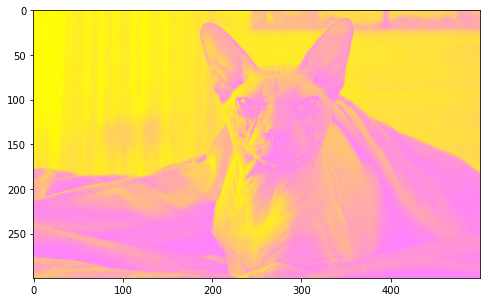

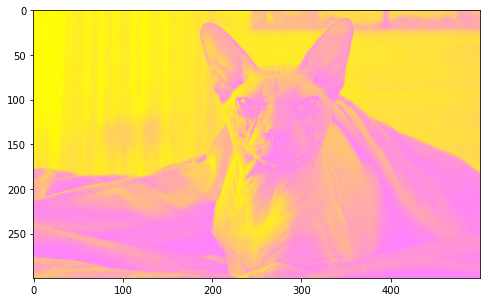

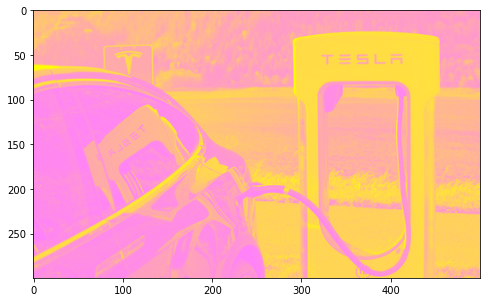

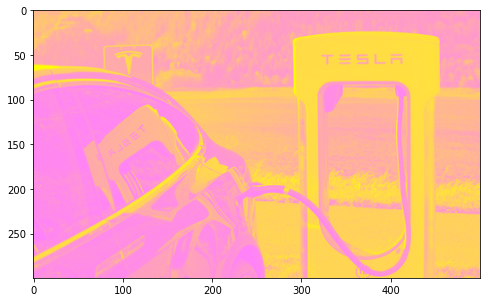

In [7]:
for _data in img_names:
  image = Image.open(_data)
  image = ImageOps.grayscale(image)

  image = ImageOps.colorize(image, 'green', 'blue')

  image = ImageOps.invert(image)
  draw_img(image)

  draw_img(image)
  image.save('grayscale_colorize_bg_inverted_'+ _data)
  new_img_names.append('grayscale_colorize_bg_inverted_'+ _data)

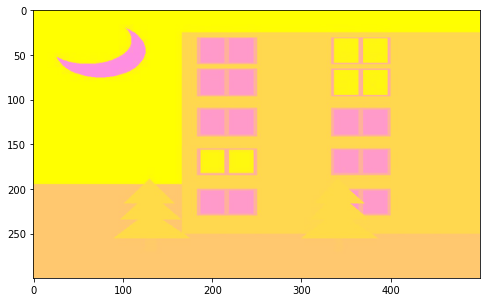

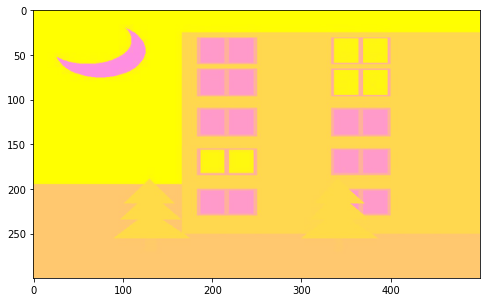

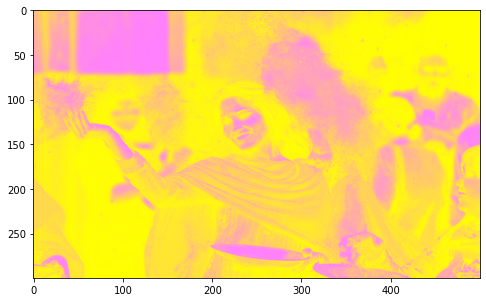

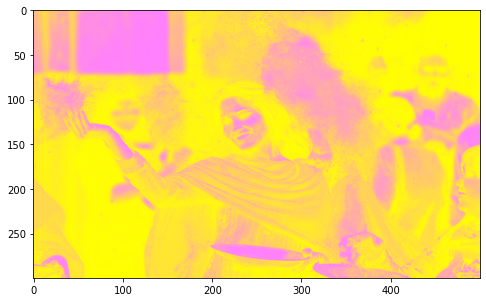

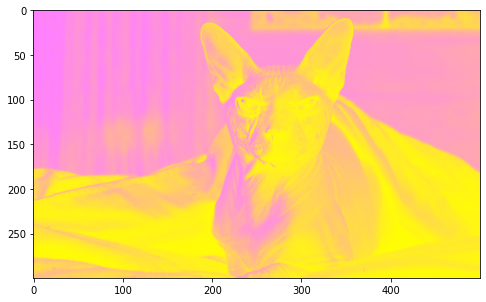

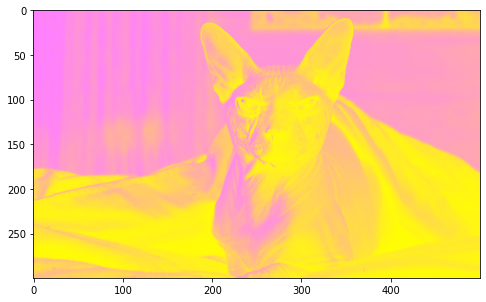

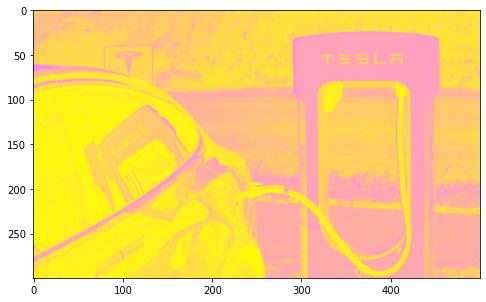

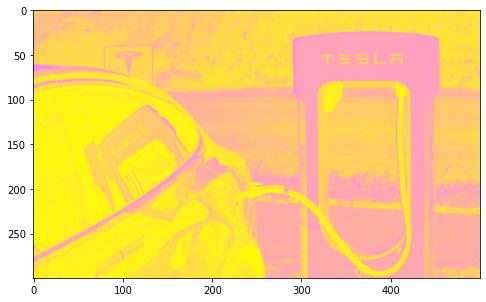

In [8]:
for _data in img_names:
  image = Image.open(_data)
  image = ImageOps.grayscale(image)

  image = ImageOps.colorize(image, 'blue', 'green')

  image = ImageOps.invert(image)
  draw_img(image)

  draw_img(image)
  image.save('grayscale_colorize_bg_inverted_'+ _data)
  new_img_names.append('grayscale_colorize_bg_inverted_'+ _data)

В этом случае мы получаем результаты инверсии цвета, в которых инвертированные изображения отличаются друг от друга лишь набором цветов (инвертированные опорные цвета)

**Задание 4.** Используя метод transpose, поверните свои изображения на 90 градусов
против часовой стрелки.

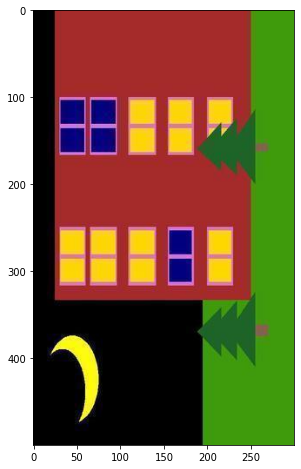

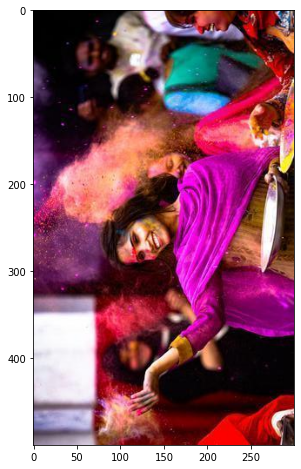

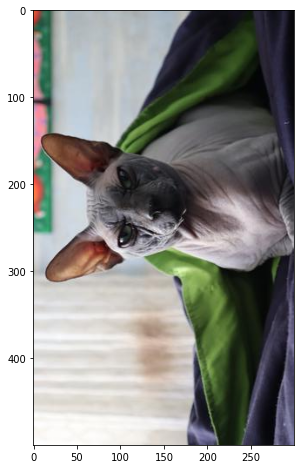

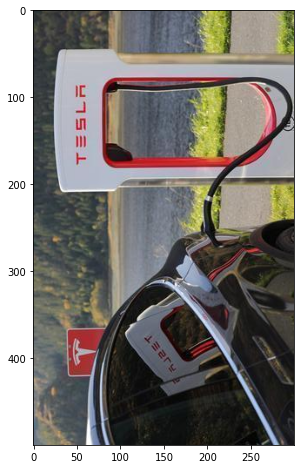

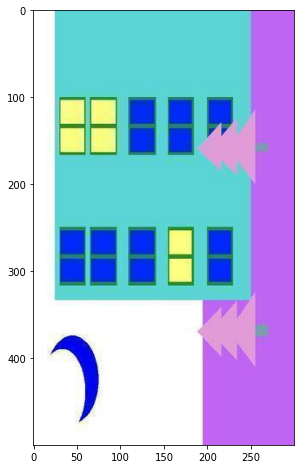

...

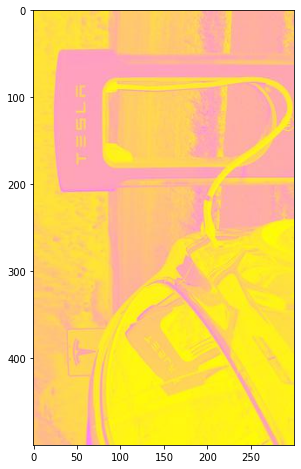

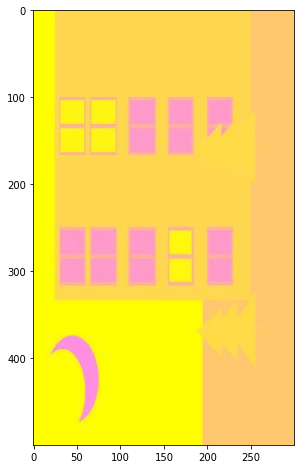

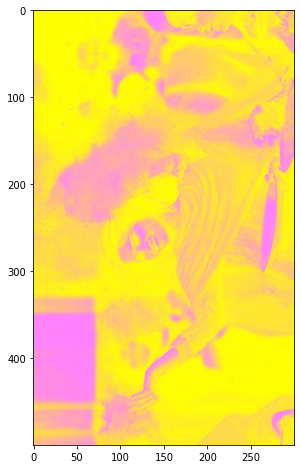

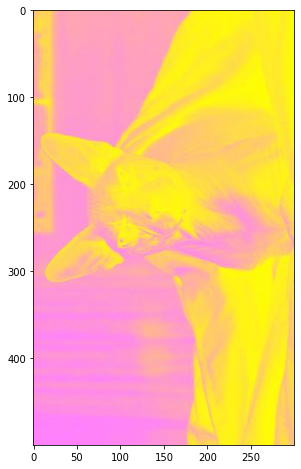

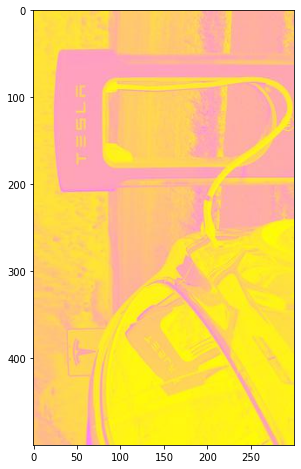

In [9]:
for _data in new_img_names:
  image = Image.open(_data) #Открываем изображение
  image = image.transpose(Image.ROTATE_90)
  draw_img(image)
  image.save('rotated90_'+ _data)

**Задание 5.** Создайте bmp-изображения с 8, 12, 16 и 24 цветами из ранее полученных
картинок

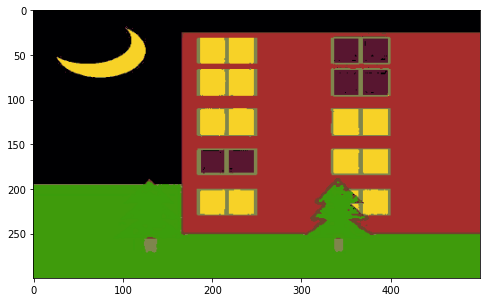

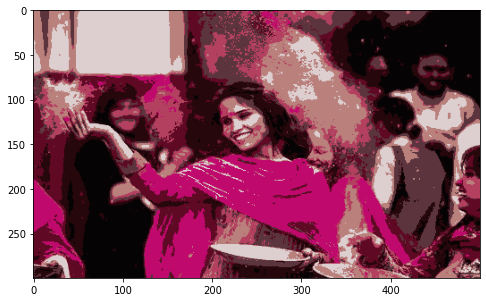

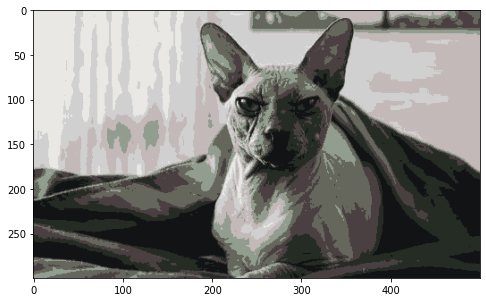

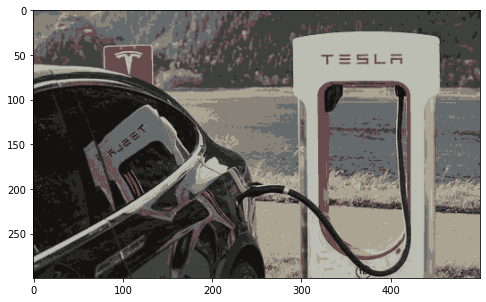

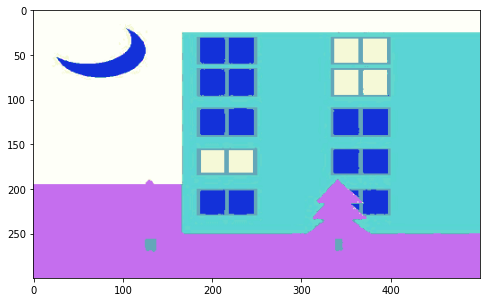

...

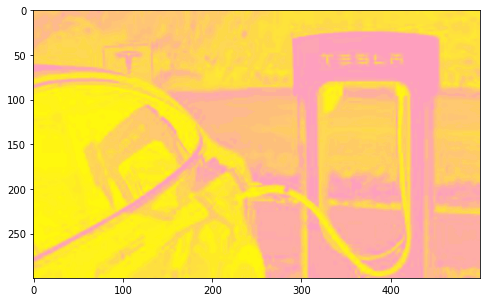

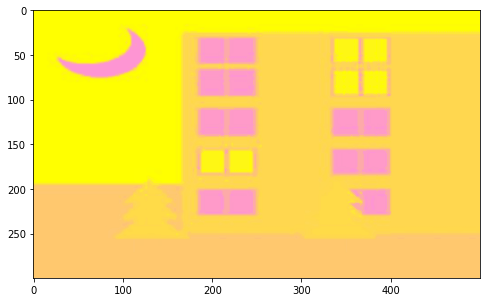

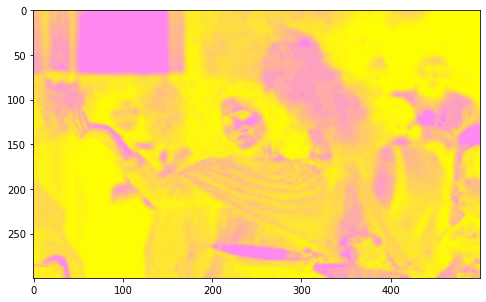

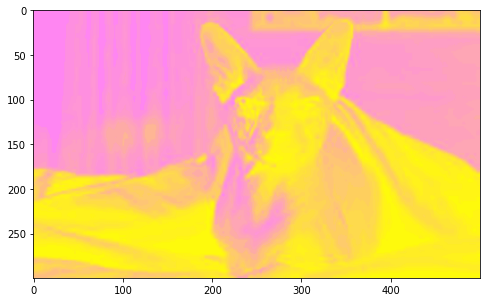

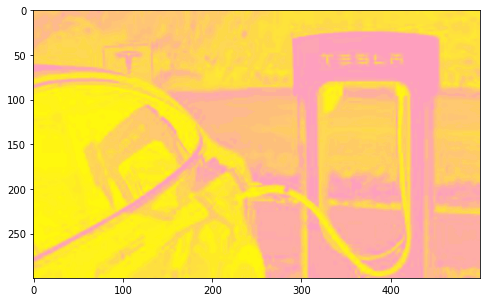

In [10]:
for _data in new_img_names:
  image = Image.open(_data)
  image = image.quantize(8)
  image.save('bmp8_'+ _data + ".bmp", "BMP")
  draw_img(image)
    
for _data in new_img_names:
  image = Image.open(_data)
  image = image.quantize(12)
  image.save('bmp12_'+ _data + ".bmp", "BMP")
  draw_img(image)

for _data in new_img_names:
  image = Image.open(_data)
  image = image.quantize(16)
  image.save('bmp16_'+ _data + ".bmp", "BMP")
  draw_img(image)
    
for _data in new_img_names:
  image = Image.open(_data)
  image = image.quantize(24)
  image.save('bmp24_'+ _data + ".bmp", "BMP")
  draw_img(image)